# Predictive Maintenance
---
**Author**: Victor Martins de Almeida

**Contact**: `vm.almeida9@gmail.com`


# Import Libs & Load Data

In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from pandas_profiling import ProfileReport

In [2]:
cols = [
    'asset_id',
    'runtime',
    'setting1',
    'setting2',
    'setting3',
]

for i in range(1,22):
    cols.append(f'tag{i}')

In [3]:
len(cols)

26

#### Use with care!!!

In [4]:
# pd.set_option('display.max_rows',500)
pd.set_option('display.max_columns',None)

## Load Data

In [5]:
df = pd.read_csv('Test/dataset_pred_maint/PM_train.txt', 
                 header=None, 
                 delimiter='\s',
                 names=cols,
                 engine='python')

In [6]:
df.head()

,asset_id,runtime,setting1,setting2,setting3,tag1,tag2,tag3,tag4,tag5,tag6,tag7,tag8,tag9,tag10,tag11,tag12,tag13,tag14,tag15,tag16,tag17,tag18,tag19,tag20,tag21
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,21.61,554.36,2388.06,9046.19,1.3,47.47,521.66,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,21.61,553.75,2388.04,9044.07,1.3,47.49,522.28,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,21.61,554.26,2388.08,9052.94,1.3,47.27,522.42,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,21.61,554.45,2388.11,9049.48,1.3,47.13,522.86,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,21.61,554.00,2388.06,9055.15,1.3,47.28,522.19,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044


# Defining Target(s)

Failure = 1 logic: As the new runtime means a failurem everytime it resets (runtime = 1) the moment of failure is the moment that preceeds runtime = 1
RUL logic: For each runtime, we define the max value, and subtract from the current runtime. rul = 0 is the moment of failure

## Defining Failures

In [7]:
restart_indexes = df[(df['runtime'] == 1) & (df['asset_id'] != 1)].index.tolist()

failure_indexes = [index-1 for index in restart_indexes]

df = df.assign(failure=np.where(df.index.isin(failure_indexes),1,0))
df[df['failure']==1]

,asset_id,runtime,setting1,setting2,setting3,tag1,tag2,tag3,tag4,tag5,tag6,tag7,tag8,tag9,tag10,tag11,tag12,tag13,tag14,tag15,tag16,tag17,tag18,tag19,tag20,tag21,failure
191,1,192,0.0009,-0.0000,100.0,518.67,643.54,1601.41,1427.20,14.62,21.61,551.25,2388.32,9033.22,1.3,48.25,520.08,2388.32,8110.93,8.5113,0.03,396,2388,100.0,38.48,22.9649,1
478,2,287,-0.0005,0.0006,100.0,518.67,643.85,1608.50,1430.84,14.62,21.61,551.66,2388.20,9109.36,1.3,48.12,519.81,2388.21,8175.57,8.5365,0.03,398,2388,100.0,38.43,23.0848,1
657,3,179,0.0012,0.0000,100.0,518.67,643.51,1604.80,1428.23,14.62,21.61,551.91,2388.14,9197.52,1.3,48.09,519.53,2388.20,8255.34,8.5056,0.03,398,2388,100.0,38.40,22.9562,1
846,4,189,-0.0024,-0.0002,100.0,518.67,644.53,1612.11,1432.55,14.62,21.61,551.93,2388.13,9198.32,1.3,48.15,519.84,2388.16,8259.42,8.5246,0.03,398,2388,100.0,38.44,23.1006,1
1115,5,269,0.0022,0.0003,100.0,518.67,643.46,1597.28,1430.74,14.62,21.61,550.77,2388.18,9157.05,1.3,48.26,519.86,2388.16,8212.75,8.5209,0.03,397,2388,100.0,38.45,23.0296,1
1303,6,188,0.0014,-0.0004,100.0,518.67,643.47,1600.63,1434.92,14.62,21.61,550.70,2388.34,9027.96,1.3,48.21,518.98,2388.34,8102.82,8.5358,0.03,397,2388,100.0,38.42,22.9577,1
1562,7,259,0.0043,-0.0001,100.0,518.67,644.15,1599.33,1435.04,14.62,21.61,551.97,2388.19,9075.94,1.3,47.97,519.10,2388.24,8145.75,8.5162,0.03,396,2388,100.0,38.46,23.0596,1
1712,8,150,0.0026,-0.0003,100.0,518.67,643.87,1602.84,1432.31,14.62,21.61,551.08,2388.27,9046.16,1.3,48.24,519.57,2388.26,8121.27,8.5509,0.03,394,2388,100.0,38.24,23.0510,1
1913,9,201,-0.0016,0.0004,100.0,518.67,644.04,1595.36,1428.43,14.62,21.61,552.30,2388.50,9239.76,1.3,48.11,520.28,2388.56,8289.63,8.5156,0.03,399,2388,100.0,38.45,23.0284,1
2135,10,222,0.0002,-0.0003,100.0,518.67,643.66,1599.18,1436.29,14.62,21.61,552.70,2388.22,9115.44,1.3,48.09,520.02,2388.16,8183.55,8.5159,0.03,398,2388,100.0,38.51,23.1434,1


## Defining RUL (Remaining Useful Life)

In [8]:
df['max_runtime'] = df.groupby('asset_id')['runtime'].transform(max)
df['rul'] = df['max_runtime'] - df['runtime']
df.drop('max_runtime', inplace=True,axis=1)
df.head()

,asset_id,runtime,setting1,setting2,setting3,tag1,tag2,tag3,tag4,tag5,tag6,tag7,tag8,tag9,tag10,tag11,tag12,tag13,tag14,tag15,tag16,tag17,tag18,tag19,tag20,tag21,failure,rul
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,21.61,554.36,2388.06,9046.19,1.3,47.47,521.66,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190,0,191
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,21.61,553.75,2388.04,9044.07,1.3,47.49,522.28,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236,0,190
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,21.61,554.26,2388.08,9052.94,1.3,47.27,522.42,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442,0,189
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,21.61,554.45,2388.11,9049.48,1.3,47.13,522.86,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739,0,188
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,21.61,554.00,2388.06,9055.15,1.3,47.28,522.19,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044,0,187


# EDA

In [9]:
df.describe()

,asset_id,runtime,setting1,setting2,setting3,tag1,tag2,tag3,tag4,tag5,tag6,tag7,tag8,tag9,tag10,tag11,tag12,tag13,tag14,tag15,tag16,tag17,tag18,tag19,tag20,tag21,failure,rul
count,20631.000000,20631.000000,20631.000000,20631.000000,20631.0,2.063100e+04,20631.000000,20631.000000,20631.000000,2.063100e+04,20631.000000,20631.000000,20631.000000,20631.000000,2.063100e+04,20631.000000,20631.000000,20631.000000,20631.000000,20631.000000,2.063100e+04,20631.000000,20631.0,20631.0,20631.000000,20631.000000,20631.000000,20631.000000
mean,51.506568,108.807862,-0.000009,0.000002,100.0,5.186700e+02,642.680934,1590.523119,1408.933782,1.462000e+01,21.609803,553.367711,2388.096652,9065.242941,1.300000e+00,47.541168,521.413470,2388.096152,8143.752722,8.442146,3.000000e-02,393.210654,2388.0,100.0,38.816271,23.289705,0.004799,107.807862
std,29.227633,68.880990,0.002187,0.000293,0.0,6.537152e-11,0.500053,6.131150,9.000605,3.394700e-12,0.001389,0.885092,0.070985,22.082880,4.660829e-13,0.267087,0.737553,0.071919,19.076176,0.037505,1.556432e-14,1.548763,0.0,0.0,0.180746,0.108251,0.069107,68.880990
min,1.000000,1.000000,-0.008700,-0.000600,100.0,5.186700e+02,641.210000,1571.040000,1382.250000,1.462000e+01,21.600000,549.850000,2387.900000,9021.730000,1.300000e+00,46.850000,518.690000,2387.880000,8099.940000,8.324900,3.000000e-02,388.000000,2388.0,100.0,38.140000,22.894200,0.000000,0.000000
25%,26.000000,52.000000,-0.001500,-0.000200,100.0,5.186700e+02,642.325000,1586.260000,1402.360000,1.462000e+01,21.610000,552.810000,2388.050000,9053.100000,1.300000e+00,47.350000,520.960000,2388.040000,8133.245000,8.414900,3.000000e-02,392.000000,2388.0,100.0,38.700000,23.221800,0.000000,51.000000
50%,52.000000,104.000000,0.000000,0.000000,100.0,5.186700e+02,642.640000,1590.100000,1408.040000,1.462000e+01,21.610000,553.440000,2388.090000,9060.660000,1.300000e+00,47.510000,521.480000,2388.090000,8140.540000,8.438900,3.000000e-02,393.000000,2388.0,100.0,38.830000,23.297900,0.000000,103.000000
75%,77.000000,156.000000,0.001500,0.000300,100.0,5.186700e+02,643.000000,1594.380000,1414.555000,1.462000e+01,21.610000,554.010000,2388.140000,9069.420000,1.300000e+00,47.700000,521.950000,2388.140000,8148.310000,8.465600,3.000000e-02,394.000000,2388.0,100.0,38.950000,23.366800,0.000000,155.000000
max,100.000000,362.000000,0.008700,0.000600,100.0,5.186700e+02,644.530000,1616.910000,1441.490000,1.462000e+01,21.610000,556.060000,2388.560000,9244.590000,1.300000e+00,48.530000,523.380000,2388.560000,8293.720000,8.584800,3.000000e-02,400.000000,2388.0,100.0,39.430000,23.618400,1.000000,361.000000


In [10]:
df.dtypes

asset_id      int64
runtime       int64
setting1    float64
setting2    float64
setting3    float64
tag1        float64
tag2        float64
tag3        float64
tag4        float64
tag5        float64
tag6        float64
tag7        float64
tag8        float64
tag9        float64
tag10       float64
tag11       float64
tag12       float64
tag13       float64
tag14       float64
tag15       float64
tag16       float64
tag17         int64
tag18         int64
tag19       float64
tag20       float64
tag21       float64
failure       int32
rul           int64
dtype: object

In [11]:
profile = ProfileReport(df, title="Pandas Profiling Report",explorative=True)

In [12]:
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/41 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Summary of Report:
* _setting3, tag1, tag5, tag10, tag16, tag18, tag19_ will be **removed** due to constant values
* _tag6_ has only 2 values (21.61 and 21.6), so we will **discard** that as well
* No missing(null) values
* _tag2, tag3, tag4, tag15 and tag17_ follows a gaussian pattern
* _tag7, tag12, tag20 and tag21_ are **right skewed**, which may explain the failure
* _tag8, tag9, tag11, tag13, tag14_ are **left skewed**, which may explain the failure
* We will remake pairplots and correlations for better visualizaton

## Drop Columns

In [13]:
drop_columns = ['setting3','tag1','tag5','tag6','tag10','tag16','tag18','tag19']

df.drop(drop_columns, axis=1, inplace=True)

In [14]:
df.describe()

,asset_id,runtime,setting1,setting2,tag2,tag3,tag4,tag7,tag8,tag9,tag11,tag12,tag13,tag14,tag15,tag17,tag20,tag21,failure,rul
count,20631.000000,20631.000000,20631.000000,20631.000000,20631.000000,20631.000000,20631.000000,20631.000000,20631.000000,20631.000000,20631.000000,20631.000000,20631.000000,20631.000000,20631.000000,20631.000000,20631.000000,20631.000000,20631.000000,20631.000000
mean,51.506568,108.807862,-0.000009,0.000002,642.680934,1590.523119,1408.933782,553.367711,2388.096652,9065.242941,47.541168,521.413470,2388.096152,8143.752722,8.442146,393.210654,38.816271,23.289705,0.004799,107.807862
std,29.227633,68.880990,0.002187,0.000293,0.500053,6.131150,9.000605,0.885092,0.070985,22.082880,0.267087,0.737553,0.071919,19.076176,0.037505,1.548763,0.180746,0.108251,0.069107,68.880990
min,1.000000,1.000000,-0.008700,-0.000600,641.210000,1571.040000,1382.250000,549.850000,2387.900000,9021.730000,46.850000,518.690000,2387.880000,8099.940000,8.324900,388.000000,38.140000,22.894200,0.000000,0.000000
25%,26.000000,52.000000,-0.001500,-0.000200,642.325000,1586.260000,1402.360000,552.810000,2388.050000,9053.100000,47.350000,520.960000,2388.040000,8133.245000,8.414900,392.000000,38.700000,23.221800,0.000000,51.000000
50%,52.000000,104.000000,0.000000,0.000000,642.640000,1590.100000,1408.040000,553.440000,2388.090000,9060.660000,47.510000,521.480000,2388.090000,8140.540000,8.438900,393.000000,38.830000,23.297900,0.000000,103.000000
75%,77.000000,156.000000,0.001500,0.000300,643.000000,1594.380000,1414.555000,554.010000,2388.140000,9069.420000,47.700000,521.950000,2388.140000,8148.310000,8.465600,394.000000,38.950000,23.366800,0.000000,155.000000
max,100.000000,362.000000,0.008700,0.000600,644.530000,1616.910000,1441.490000,556.060000,2388.560000,9244.590000,48.530000,523.380000,2388.560000,8293.720000,8.584800,400.000000,39.430000,23.618400,1.000000,361.000000


## Correlation Plot

In [15]:
corr = df.drop('asset_id',axis=1).corr().round(2)
corr

,runtime,setting1,setting2,tag2,tag3,tag4,tag7,tag8,tag9,tag11,tag12,tag13,tag14,tag15,tag17,tag20,tag21,failure,rul
runtime,1.00,-0.00,0.02,0.55,0.54,0.62,-0.60,0.48,0.44,0.63,-0.61,0.48,0.37,0.59,0.57,-0.58,-0.59,0.10,-0.74
setting1,-0.00,1.00,0.01,0.01,-0.01,0.01,-0.01,-0.00,-0.00,0.01,-0.00,0.00,-0.00,0.01,0.00,-0.01,-0.01,0.00,-0.00
setting2,0.02,0.01,1.00,0.01,0.01,0.01,-0.02,0.01,-0.01,0.01,-0.01,0.02,-0.01,0.01,0.01,-0.01,-0.01,-0.01,-0.00
tag2,0.55,0.01,0.01,1.00,0.60,0.71,-0.70,0.66,0.27,0.74,-0.72,0.66,0.18,0.68,0.63,-0.66,-0.67,0.14,-0.61
tag3,0.54,-0.01,0.01,0.60,1.00,0.68,-0.66,0.60,0.32,0.70,-0.68,0.60,0.24,0.64,0.60,-0.63,-0.63,0.14,-0.58
tag4,0.62,0.01,0.01,0.71,0.68,1.00,-0.79,0.75,0.30,0.83,-0.82,0.75,0.19,0.76,0.70,-0.75,-0.75,0.17,-0.68
tag7,-0.60,-0.01,-0.02,-0.70,-0.66,-0.79,1.00,-0.77,-0.22,-0.82,0.81,-0.76,-0.11,-0.75,-0.69,0.74,0.74,-0.16,0.66
tag8,0.48,-0.00,0.01,0.66,0.60,0.75,-0.77,1.00,-0.03,0.78,-0.79,0.83,-0.14,0.70,0.63,-0.69,-0.69,0.15,-0.56
tag9,0.44,-0.00,-0.01,0.27,0.32,0.30,-0.22,-0.03,1.00,0.27,-0.21,-0.03,0.96,0.29,0.34,-0.29,-0.29,0.11,-0.39
tag11,0.63,0.01,0.01,0.74,0.70,0.83,-0.82,0.78,0.27,1.00,-0.85,0.78,0.16,0.78,0.72,-0.77,-0.77,0.17,-0.70


<AxesSubplot:>

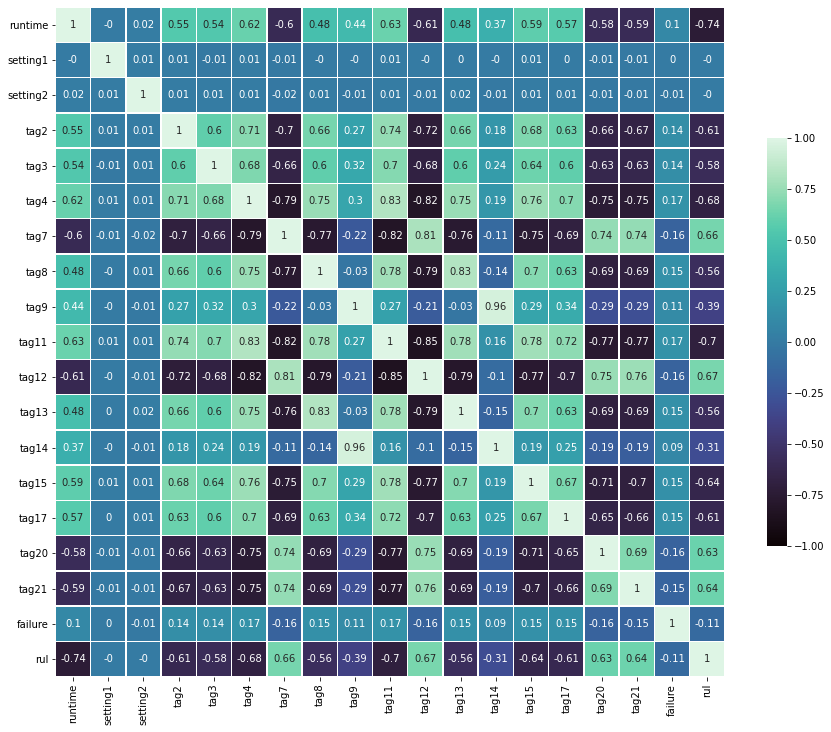

In [16]:
mask = np.triu(np.ones_like(corr, dtype=bool))
f, ax = plt.subplots(figsize=(15, 15))
sns.heatmap(corr,cmap = 'mako' ,vmax=1, vmin=-1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)

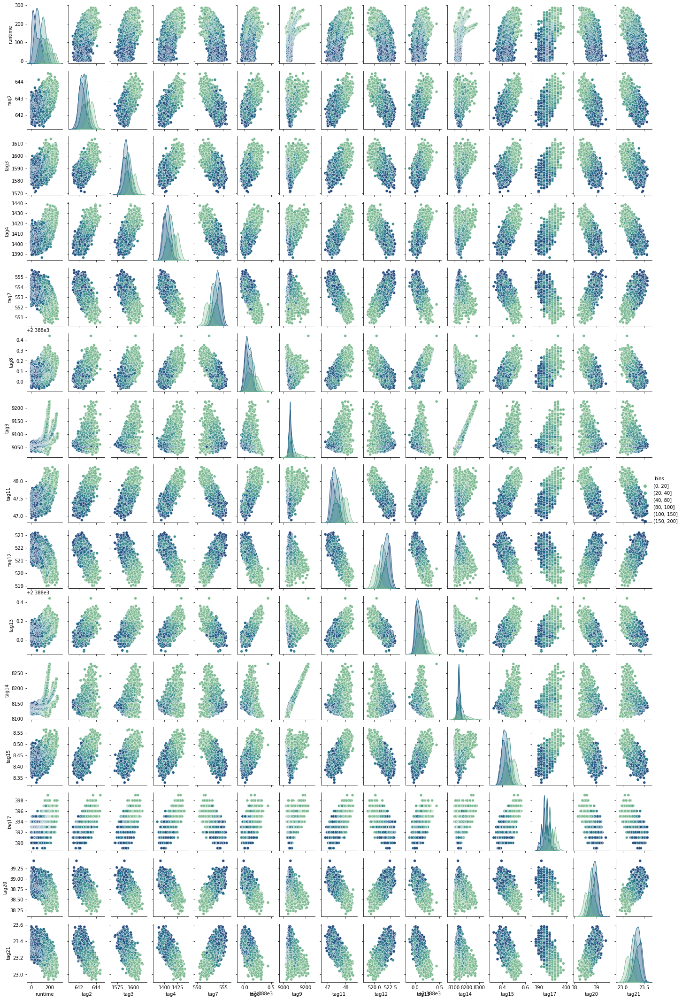

In [18]:
bins = [0, 20, 40, 80, 100, 150, 200]
drop_cols = ['setting1','setting2','rul','failure','asset_id']

# Sample of the first 20 assets
df['bins'] = pd.cut(df['rul'],bins)

df_sample = df[df['asset_id'].isin(range(1,21))]

g = sns.pairplot(df_sample.drop(drop_cols,axis=1),hue='bins',palette='crest')
g.fig.set_size_inches(20,30)

Interpretations:

Correlations plot:

* _setting1 and setting2_ has low correlation with every other feature
* As expected, _runtime_ and _rul_ are negatively correlated (the more time a machine is running, the higher is the chance to fail)
* _failure_ has no high correlation with no other feature, meaning that the moment of failure is a combination of many features
* _rul_ has a significant **positive correlation** with _tag7, tag12, tag20 and tag21_ and **negative correlation** with _tag2, tag3, tag4, tag8, tag11, tag15 and tag17_. These are the most probable sensors that **may explain the failure**
* _tag7, tag12, tag20 and tag21_ are positive correlated with each other, meaning we may have multicolliearity between these variables
* _tag2, tag3, tag4, tag8, tag11, tag15 and tag17_ are also positive correlated with each other, meaning we may have multicolliearity between these variables

Pairplot:

* We created bins wich reference the RUL as a binned set (the lighter, the less time remaining that machine has)
* In every pair plot, we can see that then RUL is near 0 (lighter green), every aspect is dislocated from the original settings (when the color is darker), meaning that the failure is not spontaneous, but a gradually change of features that sometime will fail
* In a nutshell, if those features are decreasing: _tag7, tag12, tag20 ang tag21_, and if those features are increasing: _tag2, tag3, tag4, tag8, tag9, tag11, tag13, tag14, tag15 and tag 17_, we can expect a failure (almost the same conclusions we found at the correlations plot)

## Time Plots

### RUL Behaviour

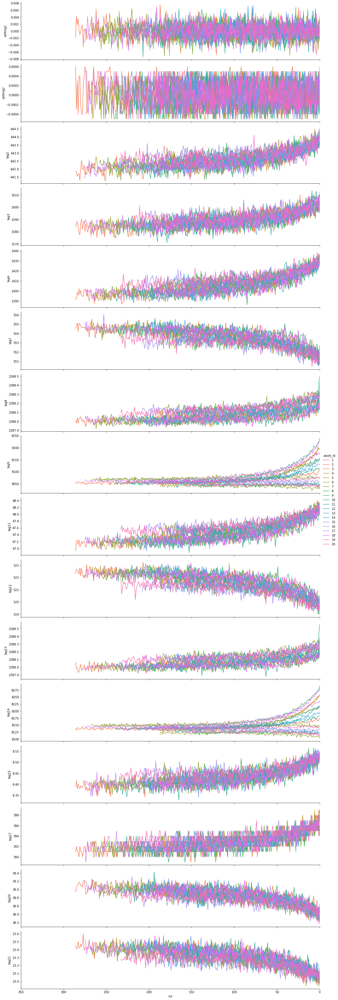

In [19]:
drop_cols2 = ['asset_id','runtime','rul','bins','failure']

x_vars=df_sample.index
df_cols = df.drop(drop_cols2,axis=1).columns

g = sns.PairGrid(data=df_sample, x_vars='rul', y_vars=df_cols, hue='asset_id',height=3, aspect=5)
g.map(plt.plot)
g.add_legend()
g.set(xlim=(350,0))

### Failure points (if single machine)

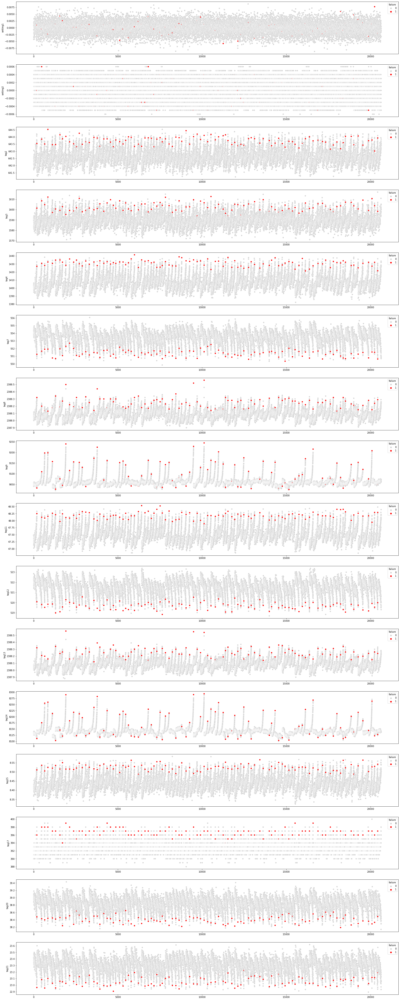

In [20]:
x_vars = df_sample.index

f,ax = plt.subplots(len(df_cols), figsize=(30,80))
for i,col in enumerate(df_cols):
    sns.scatterplot(data=df, x=df.index, y=col, hue='failure', palette=('lightgrey','red'), ax=ax[i])

Interpretation:

* Most sensors will have a change of value until the failure, and in the failure will be astrayed from the initial value
* The _setting1 and seeting2_ will likely not influence on the models
* _tag9 and tag14_ sometimes influences, sometimes not

# Pre-processing

## Feature Engineering

Since we have too much noise on every sensor, we will create moving averages to get the tendencies of the sensors, and also clean the white noise

<AxesSubplot:>

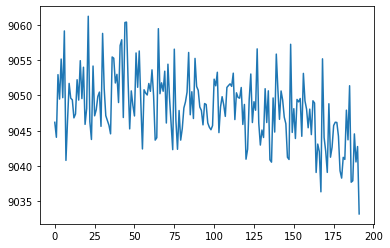

In [21]:
df[df['asset_id']==1]['tag9'].plot()

<AxesSubplot:>

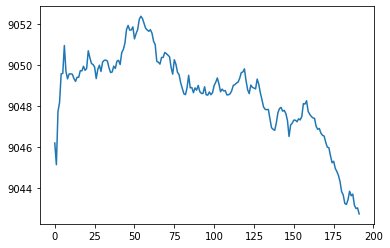

In [22]:
df[df['asset_id']==1]['tag9'].rolling(20, min_periods=1).mean().plot()

In [23]:
rw_cols = ['tag2', 'tag3', 'tag4', 'tag7', 'tag8', 'tag9', 'tag11', 'tag12', 'tag13', 'tag14', 'tag15', 'tag17', 'tag20', 'tag21']

In [24]:
for row in rw_cols:
    df[f'rw_' + row ] = df.groupby('asset_id')[row].transform(lambda x: x.rolling(20, min_periods=1).mean())

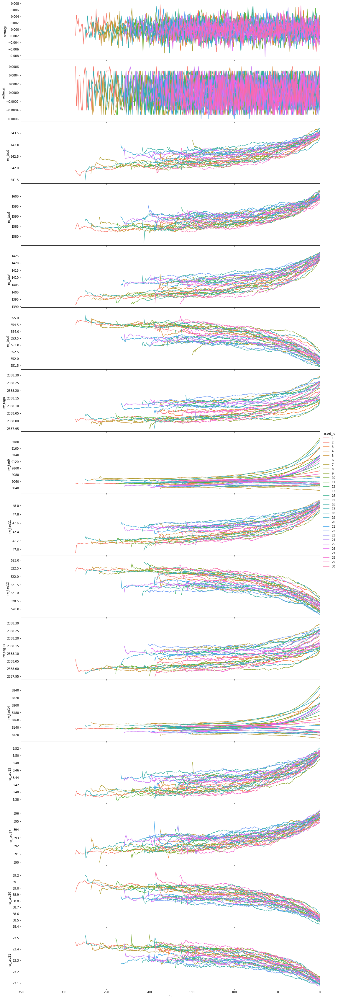

In [25]:
drop_cols3 = ['asset_id','runtime','rul','bins','failure'] + rw_cols

x_vars=df_sample.index
df_cols = df.drop(drop_cols3,axis=1).columns

g = sns.PairGrid(data=df[df['asset_id'].isin(range(1,31))], x_vars='rul', y_vars=df_cols, hue='asset_id',height=3, aspect=5)
g.map(plt.plot)
g.add_legend()
g.set(xlim=(350,0))

## Scaling

For better results, we will usa a StandardScaler for normalizing the data

In [26]:
from sklearn.preprocessing import StandardScaler

scaling_cols = ['setting1', 'setting2', 'tag2', 'tag3', 'tag4', 'tag7', 'tag8',
                'tag9', 'tag11', 'tag12', 'tag13', 'tag14', 'tag15','tag17', 'tag20',
                'tag21','rw_tag2', 'rw_tag3', 'rw_tag4', 'rw_tag7', 'rw_tag8',
                'rw_tag9', 'rw_tag11','rw_tag12', 'rw_tag13', 'rw_tag14', 'rw_tag15',
                'rw_tag17', 'rw_tag20','rw_tag21','runtime']

scaler = StandardScaler()

df_scaled = pd.DataFrame(scaler.fit_transform(df[scaling_cols]),columns=scaling_cols)
df_scaled = df_scaled.join(df[['asset_id','rul']])
df_scaled.head()

,setting1,setting2,tag2,tag3,tag4,tag7,tag8,tag9,tag11,tag12,tag13,tag14,tag15,tag17,tag20,tag21,rw_tag2,rw_tag3,rw_tag4,rw_tag7,rw_tag8,rw_tag9,rw_tag11,rw_tag12,rw_tag13,rw_tag14,rw_tag15,rw_tag17,rw_tag20,rw_tag21,runtime,asset_id,rul
0,-0.315980,-1.372953,-1.721725,-0.134255,-0.925936,1.121141,-0.516338,-0.862813,-0.266467,0.334262,-1.058890,-0.269071,-0.603816,-0.781710,1.348493,1.194427,-2.242281,-0.040599,-1.004887,1.250865,-0.500760,-0.969791,-0.169723,0.260074,-1.156148,-0.250195,-0.645622,-0.943935,1.651760,1.441575,-1.565170,1,191
1,0.872722,-1.031720,-1.061780,0.211528,-0.643726,0.431930,-0.798093,-0.958818,-0.191583,1.174899,-0.363646,-0.642845,-0.275852,-0.781710,1.016528,1.236922,-1.783533,0.212675,-0.828247,0.820853,-0.671186,-1.029229,-0.124460,0.772125,-0.735697,-0.479113,-0.428648,-0.943935,1.429456,1.469954,-1.550652,1,190
2,-1.961874,1.015677,-0.661813,-0.413166,-0.525953,1.008155,-0.234584,-0.557139,-1.015303,1.364721,-0.919841,-0.551629,-0.649144,-2.073094,0.739891,0.503423,-1.445263,-0.007944,-0.720223,0.917194,-0.500760,-0.883251,-0.441301,1.019892,-0.819787,-0.518176,-0.520965,-1.549272,1.231853,1.152850,-1.536134,1,189
3,0.324090,-0.008022,-0.661813,-1.261314,-0.784831,1.222827,0.188048,-0.713826,-1.539489,1.961302,-0.224597,-0.520176,-1.971665,-0.781710,0.352598,0.777792,-1.276129,-0.428873,-0.747229,1.032334,-0.287728,-0.858765,-0.758142,1.325470,-0.651607,-0.528076,-1.004600,-1.397938,1.003374,1.085913,-1.521616,1,188
4,-0.864611,-0.690488,-0.621816,-1.251528,-0.301518,0.714393,-0.516338,-0.457059,-0.977861,1.052871,-0.780793,-0.521748,-0.339845,-0.136018,0.463253,1.059552,-1.163527,-0.678563,-0.642428,0.974529,-0.330334,-0.780487,-0.812458,1.287479,-0.685243,-0.534401,-0.862949,-1.125536,0.895928,1.121016,-1.507098,1,187


## OOT (Out-of-Time) division

Since our dataset it is a sequential time series, we will use the last 20 assets_id as a **validation** dataset, and we will have the test dataset as **holdout**

In [27]:
df_scaled.columns

Index(['setting1', 'setting2', 'tag2', 'tag3', 'tag4', 'tag7', 'tag8', 'tag9',
       'tag11', 'tag12', 'tag13', 'tag14', 'tag15', 'tag17', 'tag20', 'tag21',
       'rw_tag2', 'rw_tag3', 'rw_tag4', 'rw_tag7', 'rw_tag8', 'rw_tag9',
       'rw_tag11', 'rw_tag12', 'rw_tag13', 'rw_tag14', 'rw_tag15', 'rw_tag17',
       'rw_tag20', 'rw_tag21', 'runtime', 'asset_id', 'rul'],
      dtype='object')

In [28]:
df_scaled['asset_id'].unique()

array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
        14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
        27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,
        40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,
        53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,
        66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,
        79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,
        92,  93,  94,  95,  96,  97,  98,  99, 100], dtype=int64)

In [29]:
train_cols = ['setting1', 'setting2','tag2', 'tag3', 'tag4', 'tag7', 'tag8', 'tag9', 'tag11', 'tag12', 'tag13', 'tag14', 'tag15',
              'tag17', 'tag20', 'tag21', 'rw_tag2','rw_tag3', 'rw_tag4', 'rw_tag7', 'rw_tag8', 'rw_tag9', 'rw_tag11','rw_tag12', 'rw_tag13',
              'rw_tag14', 'rw_tag15', 'rw_tag17', 'rw_tag20','rw_tag21','runtime']
test_col   = ['rul']

X_train = df_scaled[df_scaled['asset_id'] < 80][train_cols]
y_train = df_scaled[df_scaled['asset_id'] < 80][test_col]
X_val   = df_scaled[df_scaled['asset_id'] >= 80][train_cols]
y_val   = df_scaled[df_scaled['asset_id'] >= 80][test_col]

In [30]:
print(X_train.shape)
print(y_train.shape) 
print(X_val.shape)
print(y_val.shape)

(15953, 31)
(15953, 1)
(4678, 31)
(4678, 1)


# Modeling

## Ordinary Least Squares

Even though most plots represented a exponential curve, we will run OLS por removing those variables with multicolinearity and those who fails the hypothesis test.

In [31]:
from statsmodels.regression.linear_model import OLS

In [32]:
ols = OLS(y_train,X_train)
results = ols.fit()
print(results.summary())

                                 OLS Regression Results                                
Dep. Variable:                    rul   R-squared (uncentered):                   0.218
Model:                            OLS   Adj. R-squared (uncentered):              0.217
Method:                 Least Squares   F-statistic:                              143.6
Date:                Mon, 19 Jul 2021   Prob (F-statistic):                        0.00
Time:                        17:25:30   Log-Likelihood:                         -97539.
No. Observations:               15953   AIC:                                  1.951e+05
Df Residuals:                   15922   BIC:                                  1.954e+05
Df Model:                          31                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

* As mentioned before, _setting1 and setting2_ do not contribute heavily on th model and will be removed
* For our surprise, _tag3 and tag17_ also do not pass the hypothesis test
* Other Rollig windows variables seems to fail hypothesis test as well
* The hight condition number refers to multicolliearity
* OBS: We will apply backwards removal until the model returns good values

In [33]:
X_train_2 = X_train.drop(['setting1','setting2','tag3','tag17','rw_tag13','rw_tag3','rw_tag17','rw_tag20','rw_tag7','rw_tag9','tag3'],axis=1)

In [34]:
ols = OLS(y_train,X_train_2)
results = ols.fit()
print(results.summary())

                                 OLS Regression Results                                
Dep. Variable:                    rul   R-squared (uncentered):                   0.218
Model:                            OLS   Adj. R-squared (uncentered):              0.217
Method:                 Least Squares   F-statistic:                              211.9
Date:                Mon, 19 Jul 2021   Prob (F-statistic):                        0.00
Time:                        17:25:30   Log-Likelihood:                         -97541.
No. Observations:               15953   AIC:                                  1.951e+05
Df Residuals:                   15932   BIC:                                  1.953e+05
Df Model:                          21                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

### VIF (Variace Inflaction Factor)

* We will canculate the VIF to identify the multicolliearity between variables

In [35]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif_data = pd.DataFrame()
vif_data["feature"] = X_train_2.columns
vif_data["VIF"] = [variance_inflation_factor(X_train_2.values, i)
                          for i in range(len(X_train_2.columns))]
vif_data.round(2)

,feature,VIF
0,tag2,2.95
1,tag4,5.26
2,tag7,4.63
3,tag8,5.76
4,tag9,26.13
5,tag11,7.33
6,tag12,6.26
7,tag13,5.15
8,tag14,35.27
9,tag15,3.71


In [36]:
X_train_3 = X_train_2.drop(['rw_tag2','rw_tag4','rw_tag8','rw_tag11','rw_tag12','rw_tag14','rw_tag15','rw_tag21','tag14','tag20','tag15'],axis=1)

In [37]:
ols = OLS(y_train,X_train_3)
results = ols.fit()
print(results.summary())

                                 OLS Regression Results                                
Dep. Variable:                    rul   R-squared (uncentered):                   0.217
Model:                            OLS   Adj. R-squared (uncentered):              0.216
Method:                 Least Squares   F-statistic:                              441.0
Date:                Mon, 19 Jul 2021   Prob (F-statistic):                        0.00
Time:                        17:25:30   Log-Likelihood:                         -97558.
No. Observations:               15953   AIC:                                  1.951e+05
Df Residuals:                   15943   BIC:                                  1.952e+05
Df Model:                          10                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

In [38]:
vif_data = pd.DataFrame()
vif_data["feature"] = X_train_3.columns
vif_data["VIF"] = [variance_inflation_factor(X_train_3.values, i)
                          for i in range(len(X_train_3.columns))]
vif_data.round(2)

,feature,VIF
0,tag2,2.65
1,tag4,4.49
2,tag7,4.23
3,tag8,4.66
4,tag9,1.89
5,tag11,5.88
6,tag12,5.17
7,tag13,4.64
8,tag21,3.11
9,runtime,2.11


Interpretation of what has been done

* We removed most of multicollinearity
* It seems that the rolling windows were a bad choice in the end
* Even though we cleaned up the variables that failed the hypothesis test, we will choose models that ignore multicollinearity issues (tree based algorithms) over those who are affected (regressions and kernel based)
* The another reason for using tree based models and ignore multicolliearity, is that the prediction (RUL ou Failure) is more important than understanding the features importances 
* In the end we **may** end up with more **robust models** due to this initial cleaning process
* In any way, we will test both cleaned model and full model

In [39]:
#We will ceate a funcions that will log all results into a single DataFrame for further analysis and comparison

from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_squared_log_error
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import median_absolute_error
import time

def adjusted_r2(y_esperado, y_previsto, X_treino):
    r2 = r2_score(y_esperado, y_previsto)
    N = len(y_esperado)
    p = X_treino.shape[1]

    r2_ajustado = (1 - ((1 - r2) * (N - 1)) / (N - p - 1))
    return r2_ajustado

def log_results(modelo_objeto, nome_modelo, X_train, X_test, y_train, y_test):
    #predict
    tic_train         = time.time()
    y_pred_train      = modelo_objeto.predict(X_train)
    toc_train         = time.time()
    tic_test          = time.time()
    y_pred_test       = modelo_objeto.predict(X_test)
    toc_test          = time.time()
    # metrics
    r2_train          = r2_score(y_train, y_pred_train)
    r2_test           = r2_score(y_test, y_pred_test)
    adjusted_r2_train = adjusted_r2(y_train, y_pred_train, X_train)
    adjusted_r2_test  = adjusted_r2(y_test, y_pred_test, X_train)
    mse_train         = mean_squared_error(y_train, y_pred_train)
    mse_test          = mean_squared_error(y_test, y_pred_test)
    rmse_train        = np.sqrt(mse_train)
    rmse_test         = np.sqrt(mse_test)
    mae_train         = mean_absolute_error(y_train, y_pred_train)
    mae_test          = mean_absolute_error(y_test, y_pred_test)
    medae_train       = median_absolute_error(y_train, y_pred_train)
    medae_test        = median_absolute_error(y_test, y_pred_test)
    pred_time_train   = toc_train - tic_train
    pred_time_test    = toc_test - tic_test
    # Dataframe
    results = {'model':[],'mode':[],'r2':[],'adjusted_r2':[],'mse':[],
               'rmse':[],'mae':[],'medae':[],'pred_time':[]}
    results['model'].append(nome_modelo)
    results['model'].append(nome_modelo)
    results['mode'].append('train')
    results['mode'].append('validation')
    results['r2'].append(r2_train)
    results['r2'].append(r2_test)
    results['adjusted_r2'].append(adjusted_r2_train)
    results['adjusted_r2'].append(adjusted_r2_test)
    results['mse'].append(mse_train)
    results['mse'].append(mse_test)
    results['rmse'].append(rmse_train)
    results['rmse'].append(rmse_test)
    results['mae'].append(mae_train)
    results['mae'].append(mae_test)
    results['medae'].append(medae_train)
    results['medae'].append(medae_test)
    results['pred_time'].append(pred_time_train)
    results['pred_time'].append(pred_time_test)

    return pd.DataFrame(results)

## Decision Tree

In [40]:
X_train_full = X_train
X_train_cleaned = X_train_3
X_val_full = X_val
X_val_cleaned = X_val[X_train_cleaned.columns]

In [41]:
print(X_train_full.shape)
print(X_val_cleaned.shape)
print(y_train.shape) 
print(X_val_full.shape)
print(X_val_cleaned.shape)
print(y_val.shape)

(15953, 31)
(4678, 10)
(15953, 1)
(4678, 31)
(4678, 10)
(4678, 1)


In [42]:
from sklearn.tree import DecisionTreeRegressor

dtr = DecisionTreeRegressor()
dtr.fit(X_train_full,y_train)

full_tree_results = log_results(dtr, 'Decision Tree Full', X_train_full, X_val_full, y_train, y_val)
full_tree_results

,model,mode,r2,adjusted_r2,mse,rmse,mae,medae,pred_time
0,Decision Tree Full,train,1.000000,1.000000,0.000000,0.000000,0.000000,0.0,0.008004
1,Decision Tree Full,validation,0.343077,0.338694,3881.882001,62.304751,44.218042,29.0,0.002997


In [43]:
dtr = DecisionTreeRegressor()
dtr.fit(X_train_cleaned,y_train)

cleaned_tree_results = log_results(dtr, 'Decision Tree Cleaned', X_train_cleaned, X_val_cleaned, y_train, y_val)
cleaned_tree_results

,model,mode,r2,adjusted_r2,mse,rmse,mae,medae,pred_time
0,Decision Tree Cleaned,train,1.000000,1.000000,0.000000,0.000000,0.000000,0.0,0.004003
1,Decision Tree Cleaned,validation,0.400926,0.399642,3540.043181,59.498262,42.342882,28.0,0.002997


## Random Forest

In [44]:
from sklearn.ensemble import RandomForestRegressor

rfr = RandomForestRegressor(random_state=42,n_jobs=-1)
rfr.fit(X_train_full,y_train)

full_rf_results = log_results(rfr, 'Random Forest Full', X_train_full, X_val_full, y_train, y_val)
full_rf_results

<ipython-input-44-09ed2f55c492>:4: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  rfr.fit(X_train_full,y_train)


,model,mode,r2,adjusted_r2,mse,rmse,mae,medae,pred_time
0,Random Forest Full,train,0.995935,0.995927,17.721812,4.209728,2.576915,1.510,0.066000
1,Random Forest Full,validation,0.549036,0.546027,2664.831941,51.622010,36.064297,22.495,0.047998


In [45]:
rfr = RandomForestRegressor(random_state=42,n_jobs=-1)
rfr.fit(X_train_cleaned,y_train)

cleaned_rf_results = log_results(rfr, 'Random Forest Cleaned', X_train_cleaned, X_val_cleaned, y_train, y_val)
cleaned_rf_results

<ipython-input-45-c8e698da0dc3>:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  rfr.fit(X_train_cleaned,y_train)


,model,mode,r2,adjusted_r2,mse,rmse,mae,medae,pred_time
0,Random Forest Cleaned,train,0.965281,0.965259,151.376823,12.303529,8.386997,5.69,0.085001
1,Random Forest Cleaned,validation,0.620675,0.619862,2241.505715,47.344543,33.521804,20.99,0.052998


## LightGBM

In [46]:
from lightgbm import LGBMRegressor

lgbm = LGBMRegressor(random_state=42,n_jobs=-1)
lgbm.fit(X_train_full,y_train)

full_lgbm_results = log_results(lgbm, 'LightGBM Full', X_train_full, X_val_full, y_train, y_val)
full_lgbm_results

,model,mode,r2,adjusted_r2,mse,rmse,mae,medae,pred_time
0,LightGBM Full,train,0.954268,0.954179,199.393887,14.120690,10.592703,8.161004,0.036999
1,LightGBM Full,validation,0.561689,0.558764,2590.065434,50.892685,35.389144,21.791245,0.007999


In [47]:
lgbm = LGBMRegressor(random_state=42,n_jobs=-1)
lgbm.fit(X_train_cleaned,y_train)

cleaned_lgbm_results = log_results(lgbm, 'LightGBM Cleaned', X_train_cleaned, X_val_cleaned, y_train, y_val)
cleaned_lgbm_results

,model,mode,r2,adjusted_r2,mse,rmse,mae,medae,pred_time
0,LightGBM Cleaned,train,0.816215,0.816099,801.307577,28.307377,19.512097,13.725591,0.020998
1,LightGBM Cleaned,validation,0.616057,0.615235,2268.792004,47.631838,33.687282,20.652480,0.009000


## XGBoost

In [48]:
from xgboost import XGBRegressor

xgb = XGBRegressor(random_state=42,n_jobs=-1)
xgb.fit(X_train_full,y_train)

full_xgb_results = log_results(xgb, 'XGBoost Full', X_train_full, X_val_full, y_train, y_val)
full_xgb_results

c:\users\victor\appdata\local\programs\python\python39\lib\site-packages\xgboost\data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
c:\users\victor\appdata\local\programs\python\python39\lib\site-packages\xgboost\data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(


,model,mode,r2,adjusted_r2,mse,rmse,mae,medae,pred_time
0,XGBoost Full,train,0.986406,0.986379,59.270318,7.698722,5.503808,3.932755,0.017001
1,XGBoost Full,validation,0.542823,0.539773,2701.547214,51.976410,36.308969,23.417292,0.012998


In [49]:
xgb = XGBRegressor(random_state=42,n_jobs=-1)
xgb.fit(X_train_cleaned,y_train)

cleaned_xgb_results = log_results(xgb, 'XGBoost Cleaned', X_train_cleaned, X_val_cleaned, y_train, y_val)
cleaned_xgb_results

c:\users\victor\appdata\local\programs\python\python39\lib\site-packages\xgboost\data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
c:\users\victor\appdata\local\programs\python\python39\lib\site-packages\xgboost\data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(


,model,mode,r2,adjusted_r2,mse,rmse,mae,medae,pred_time
0,XGBoost Cleaned,train,0.889242,0.889173,482.905912,21.975120,15.087990,10.188496,0.014
1,XGBoost Cleaned,validation,0.597188,0.596325,2380.294621,48.788263,34.641642,21.955536,0.011


## CatBoost

In [50]:
from catboost import CatBoostRegressor

cbr = CatBoostRegressor(random_state=42)
cbr.fit(X_train_full,y_train)

full_cbr_results = log_results(cbr, 'CatBoost Full', X_train_full, X_val_full, y_train, y_val)

Learning rate set to 0.063901
0:	learn: 63.1196086	total: 158ms	remaining: 2m 38s
1:	learn: 60.4261247	total: 164ms	remaining: 1m 21s
2:	learn: 57.9298034	total: 170ms	remaining: 56.4s
3:	learn: 55.6768132	total: 176ms	remaining: 43.7s
4:	learn: 53.5218938	total: 181ms	remaining: 36s
5:	learn: 51.6321496	total: 186ms	remaining: 30.8s
6:	learn: 49.8974802	total: 191ms	remaining: 27.2s
7:	learn: 48.2834707	total: 197ms	remaining: 24.4s
8:	learn: 46.7819047	total: 203ms	remaining: 22.3s
9:	learn: 45.4460285	total: 209ms	remaining: 20.7s
10:	learn: 44.1548858	total: 214ms	remaining: 19.3s
11:	learn: 42.9936235	total: 220ms	remaining: 18.1s
12:	learn: 41.9654425	total: 226ms	remaining: 17.1s
13:	learn: 41.0187179	total: 231ms	remaining: 16.3s
14:	learn: 40.0909744	total: 236ms	remaining: 15.5s
15:	learn: 39.2813973	total: 241ms	remaining: 14.8s
16:	learn: 38.5848074	total: 246ms	remaining: 14.2s
17:	learn: 37.9592693	total: 252ms	remaining: 13.7s
18:	learn: 37.3813545	total: 256ms	remaining

In [51]:
full_cbr_results

,model,mode,r2,adjusted_r2,mse,rmse,mae,medae,pred_time
0,CatBoost Full,train,0.973942,0.973891,113.614194,10.658996,7.896168,5.966810,0.016002
1,CatBoost Full,validation,0.571739,0.568882,2530.675804,50.305823,34.973389,22.007159,0.012000


In [52]:
cbr = CatBoostRegressor(random_state=42)
cbr.fit(X_train_cleaned,y_train)

cleaned_cbr_results = log_results(cbr, 'CatBoost Cleaned', X_train_cleaned, X_val_cleaned, y_train, y_val)

Learning rate set to 0.063901
0:	learn: 63.1898266	total: 9.22ms	remaining: 9.21s
1:	learn: 60.5628330	total: 14.2ms	remaining: 7.07s
2:	learn: 58.1484925	total: 18.2ms	remaining: 6.04s
3:	learn: 55.9095155	total: 22.7ms	remaining: 5.65s
4:	learn: 53.8238310	total: 27.5ms	remaining: 5.47s
5:	learn: 51.9188466	total: 33.3ms	remaining: 5.52s
6:	learn: 50.1777495	total: 38.3ms	remaining: 5.43s
7:	learn: 48.5995124	total: 46.6ms	remaining: 5.77s
8:	learn: 47.1219393	total: 51.9ms	remaining: 5.72s
9:	learn: 45.7733866	total: 57.1ms	remaining: 5.65s
10:	learn: 44.5462134	total: 62.2ms	remaining: 5.59s
11:	learn: 43.3738266	total: 67.6ms	remaining: 5.57s
12:	learn: 42.3335249	total: 72.8ms	remaining: 5.52s
13:	learn: 41.3963190	total: 77.7ms	remaining: 5.47s
14:	learn: 40.4975232	total: 81.9ms	remaining: 5.38s
15:	learn: 39.7417439	total: 86.2ms	remaining: 5.3s
16:	learn: 39.0717435	total: 90.8ms	remaining: 5.25s
17:	learn: 38.4100819	total: 97ms	remaining: 5.29s
18:	learn: 37.8298654	total: 

In [53]:
cleaned_cbr_results

,model,mode,r2,adjusted_r2,mse,rmse,mae,medae,pred_time
0,CatBoost Cleaned,train,0.842928,0.842830,684.834994,26.169352,18.123597,12.661114,0.007004
1,CatBoost Cleaned,validation,0.613908,0.613081,2281.492305,47.764969,33.658067,20.592270,0.004998


# Validation

We will now check with regressor peformed best

## Model Evaluation

In [54]:
results = pd.concat([full_tree_results,cleaned_tree_results,full_rf_results,cleaned_rf_results,
                    full_lgbm_results,cleaned_lgbm_results,full_xgb_results,cleaned_xgb_results,
                    full_cbr_results,cleaned_cbr_results])
results[results['mode']=='validation'].sort_values('rmse',ascending=True)

,model,mode,r2,adjusted_r2,mse,rmse,mae,medae,pred_time
1,Random Forest Cleaned,validation,0.620675,0.619862,2241.505715,47.344543,33.521804,20.990000,0.052998
1,LightGBM Cleaned,validation,0.616057,0.615235,2268.792004,47.631838,33.687282,20.652480,0.009000
1,CatBoost Cleaned,validation,0.613908,0.613081,2281.492305,47.764969,33.658067,20.592270,0.004998
1,XGBoost Cleaned,validation,0.597188,0.596325,2380.294621,48.788263,34.641642,21.955536,0.011000
1,CatBoost Full,validation,0.571739,0.568882,2530.675804,50.305823,34.973389,22.007159,0.012000
1,LightGBM Full,validation,0.561689,0.558764,2590.065434,50.892685,35.389144,21.791245,0.007999
1,Random Forest Full,validation,0.549036,0.546027,2664.831941,51.622010,36.064297,22.495000,0.047998
1,XGBoost Full,validation,0.542823,0.539773,2701.547214,51.976410,36.308969,23.417292,0.012998
1,Decision Tree Cleaned,validation,0.400926,0.399642,3540.043181,59.498262,42.342882,28.000000,0.002997
1,Decision Tree Full,validation,0.343077,0.338694,3881.882001,62.304751,44.218042,29.000000,0.002997


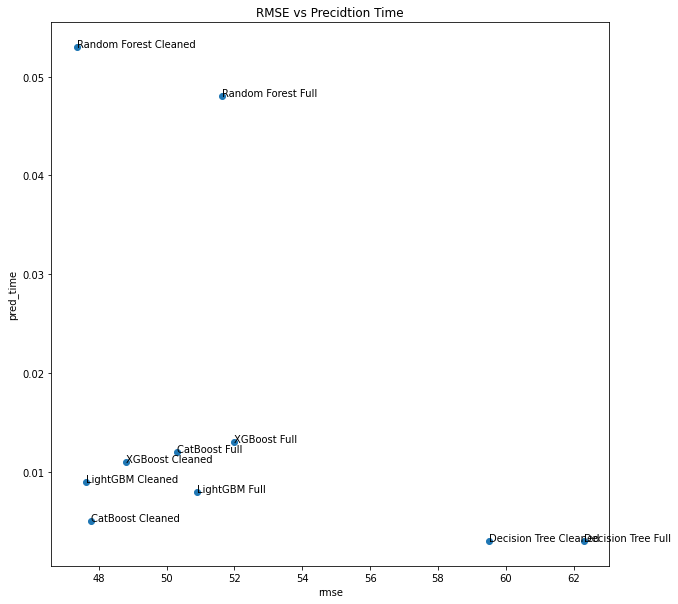

In [55]:
val_results = results[results['mode']=='validation']

x = val_results.rmse.to_list()
y = val_results.pred_time.to_list()
text = val_results.model.to_list()

fig, ax = plt.subplots(figsize=(10,10))
ax.scatter(x,y)
plt.title("RMSE vs Precidtion Time")
plt.xlabel('rmse')
plt.ylabel('pred_time')
for i, txt in enumerate(text):
    ax.annotate(txt, (x[i], y[i]))

Interpretations:

* The cleaned models performed best
* We can see that Random Forest performed best over the other ones, but was the one with higher predict time as well
* As we are dealing with IIoT devices, prediction time should be also be considered, since this model could be embarked on a microchip into the machine(s)
* Our choice will be **CatBoost** with **Cleaned Data**, since it performed similar to the other best predictors, but has the lower prediction time
* even though we had a adjusted R² of 0.61, we have to check if the model can detect our true target, the failure

## Model Predictions

In [56]:
y_pred = pd.DataFrame(cbr.predict(X_val), columns=['predictions'])

predictions = y_val.reset_index(drop=True).join(y_pred)

<AxesSubplot:title={'center':'Actual vs predictions (RUL)'}>

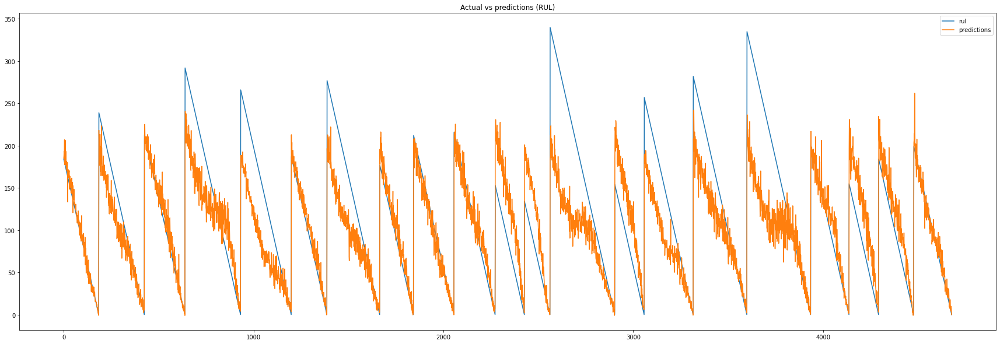

In [57]:
predictions.plot(figsize=(30,10),title = 'Actual vs predictions (RUL)')

Interpretation:

* Our model seems to identify failure pretty well. It cannot though identify high RUL values, which don't matter to us actually (and also explaining the high R²)
* We can set some values for the prediction values as:
1. CRITICAL: predictions <=20
2. DANGER: predictions >20, <= 50
3. WARNING: predictions >50, <= 100
3. NORMAL: predictions > 100

* We will classify RULs < 20 as our target and get some classifications KPIs

In [58]:
predictions = predictions.assign(rul_critical  = np.where(predictions['rul']<=20,1,0))
predictions = predictions.assign(pred_critical = np.where(predictions['predictions']<=20,1,0))
predictions = predictions.assign(classification = np.where(predictions['predictions']<=20,'CRITICAL',
                                                          np.where((predictions['predictions']>20) & (predictions['predictions']<=50),'DANGER',
                                                                  np.where((predictions['predictions']>50) & (predictions['predictions']<=100),'WARNING','NORMAL'))))
predictions

,rul,predictions,rul_critical,pred_critical,classification
0,184,185.197107,0,0,NORMAL
1,183,187.854830,0,0,NORMAL
2,182,193.331800,0,0,NORMAL
3,181,188.018817,0,0,NORMAL
4,180,206.874632,0,0,NORMAL
...,...,...,...,...,...
4673,4,7.716428,1,1,CRITICAL
4674,3,9.672593,1,1,CRITICAL
4675,2,7.733287,1,1,CRITICAL
4676,1,3.376365,1,1,CRITICAL


<AxesSubplot:ylabel='predictions'>

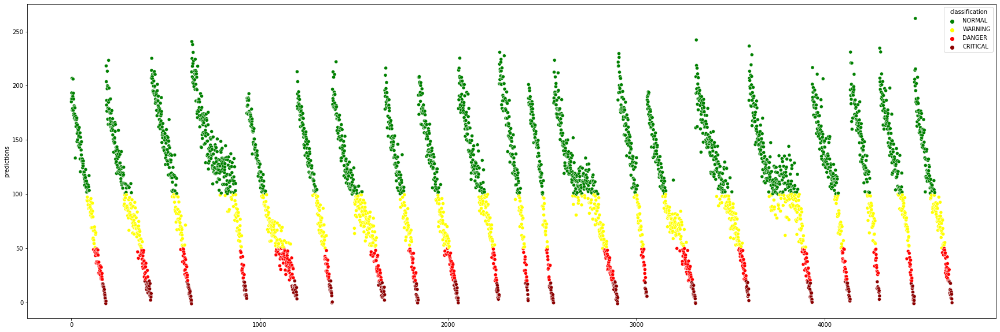

In [59]:
f,ax = plt.subplots(figsize=(30,10))
sns.scatterplot(data=predictions, x=predictions.index, y='predictions', hue='classification', palette=('green','yellow','red','darkred'))

<AxesSubplot:>

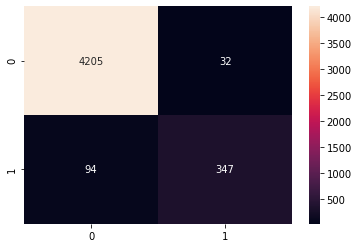

In [60]:
from sklearn.metrics import confusion_matrix

cf = confusion_matrix(predictions['rul_critical'], predictions['pred_critical'])
sns.heatmap(cf, annot=True,fmt='.5g')

In [61]:
from sklearn.metrics import classification_report, recall_score
print(classification_report(predictions['rul_critical'], predictions['pred_critical']))

              precision    recall  f1-score   support

           0       0.98      0.99      0.99      4237
           1       0.92      0.79      0.85       441

    accuracy                           0.97      4678
   macro avg       0.95      0.89      0.92      4678
weighted avg       0.97      0.97      0.97      4678



Interpretation:

* We will use recall as our KPI scoring. Since True Negatives and False Positives don't really matter to us (TN are unimportant and FP are somewhat good) we can say our model has a **Recall of 79%** of predicting critical failures

## Model Understanding

We will use SHAP library to "reveal" whats behind the CatBoost blackbox

INFO:tensorflow:Enabling eager execution
INFO:tensorflow:Enabling v2 tensorshape
INFO:tensorflow:Enabling resource variables
INFO:tensorflow:Enabling tensor equality
INFO:tensorflow:Enabling control flow v2


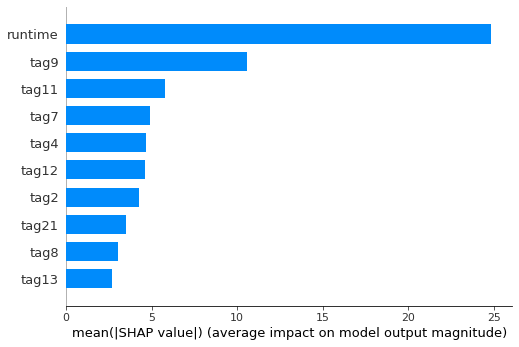

In [62]:
import shap

explainer = shap.TreeExplainer(cbr)
shap_values = explainer.shap_values(X_train_cleaned)

shap.summary_plot(shap_values, X_train_cleaned, plot_type="bar")

Interpretation:

* The highter the SAP Values, the more this feature impacts on the prediction
* _runtime_ influences more than any other variable, followed by _tag9,tag11,tag12_...

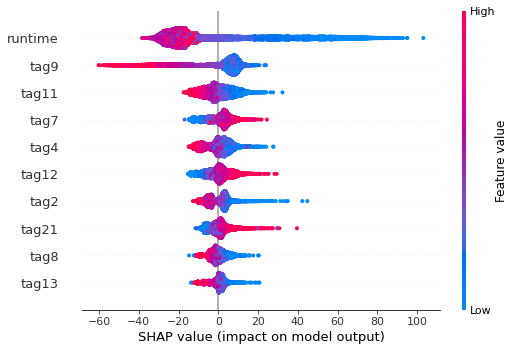

In [63]:
shap.summary_plot(shap_values, X_train_cleaned)

Interpretation:

* Red values means the higher feature value, makes a positive impact into the target. 
* As our target is "best" near 0, high values of _runtime,tag9, tag11, tag4, tag2, tag15 and tag17_ will predict failure
* Same way, low values of _tag12, tag7, tag21, tag20_ will predict failure as well

In [64]:
shap.initjs()
X_train_cleaned_sample = X_train_cleaned.iloc[:1000,:]
shap.force_plot(explainer.expected_value, shap_values[:1000,:], X_train_cleaned_sample)

In [65]:
index=0
shap.force_plot(explainer.expected_value, shap_values[index,:], X_train_cleaned.iloc[index,:])

In [66]:
index=190
shap.force_plot(explainer.expected_value, shap_values[index,:], X_train_cleaned.iloc[index,:])

Interpretation:
    
* These are single value explanations, and how eah variable impacts on the result
* Values are Standarized

# Deploy

## Predict Pipeline

### Load Data

In [67]:
df_train = df_holdout = pd.read_csv('Test/dataset_pred_maint/PM_train.txt', 
                      header=None, 
                      delimiter='\s',
                      names=cols,
                      engine='python')

In [68]:
df_holdout = pd.read_csv('Test/dataset_pred_maint/PM_test.txt', 
                      header=None, 
                      delimiter='\s',
                      names=cols,
                      engine='python')

In [69]:
df_train.head()

,asset_id,runtime,setting1,setting2,setting3,tag1,tag2,tag3,tag4,tag5,tag6,tag7,tag8,tag9,tag10,tag11,tag12,tag13,tag14,tag15,tag16,tag17,tag18,tag19,tag20,tag21
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,21.61,554.36,2388.06,9046.19,1.3,47.47,521.66,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,21.61,553.75,2388.04,9044.07,1.3,47.49,522.28,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,21.61,554.26,2388.08,9052.94,1.3,47.27,522.42,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,21.61,554.45,2388.11,9049.48,1.3,47.13,522.86,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,21.61,554.00,2388.06,9055.15,1.3,47.28,522.19,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044


In [70]:
df_holdout.head()

,asset_id,runtime,setting1,setting2,setting3,tag1,tag2,tag3,tag4,tag5,tag6,tag7,tag8,tag9,tag10,tag11,tag12,tag13,tag14,tag15,tag16,tag17,tag18,tag19,tag20,tag21
0,1,1,0.0023,0.0003,100.0,518.67,643.02,1585.29,1398.21,14.62,21.61,553.90,2388.04,9050.17,1.3,47.20,521.72,2388.03,8125.55,8.4052,0.03,392,2388,100.0,38.86,23.3735
1,1,2,-0.0027,-0.0003,100.0,518.67,641.71,1588.45,1395.42,14.62,21.61,554.85,2388.01,9054.42,1.3,47.50,522.16,2388.06,8139.62,8.3803,0.03,393,2388,100.0,39.02,23.3916
2,1,3,0.0003,0.0001,100.0,518.67,642.46,1586.94,1401.34,14.62,21.61,554.11,2388.05,9056.96,1.3,47.50,521.97,2388.03,8130.10,8.4441,0.03,393,2388,100.0,39.08,23.4166
3,1,4,0.0042,0.0000,100.0,518.67,642.44,1584.12,1406.42,14.62,21.61,554.07,2388.03,9045.29,1.3,47.28,521.38,2388.05,8132.90,8.3917,0.03,391,2388,100.0,39.00,23.3737
4,1,5,0.0014,0.0000,100.0,518.67,642.51,1587.19,1401.92,14.62,21.61,554.16,2388.01,9044.55,1.3,47.31,522.15,2388.03,8129.54,8.4031,0.03,390,2388,100.0,38.99,23.4130


In [71]:
def preprocessing_train(df):
    # create target
    df['max_runtime'] = df.groupby('asset_id')['runtime'].transform(max)
    df['rul'] = df['max_runtime'] - df['runtime']
    df.drop('max_runtime', inplace=True,axis=1)
    
    # filter columns 
    columns = ['tag2', 'tag4', 'tag7', 'tag8', 'tag9', 'tag11', 'tag12', 'tag13','tag21', 'runtime','rul']
    df = df[columns]
    
    return df

def preprocessing_test(df):
    # filter columns 
    columns = ['asset_id','tag2', 'tag4', 'tag7', 'tag8', 'tag9', 'tag11', 'tag12', 'tag13','tag21', 'runtime']
    df = df[columns]
    
    return df

### Train model with full data

In [72]:
from sklearn.preprocessing import StandardScaler
from feature_engine.wrappers import SklearnTransformerWrapper
from sklearn.pipeline import Pipeline

features = ['tag2', 'tag4', 'tag7', 'tag8', 'tag9', 'tag11', 'tag12', 'tag13','tag21', 'runtime']

stw = SklearnTransformerWrapper(transformer = StandardScaler(),
                                    variables = features)
model = Pipeline([
    ('stw',stw),
    ('cbr',CatBoostRegressor(random_state=42))
])

df_model = preprocessing_train(df_train)
X_train = df_model.drop(['rul'],axis=1)
y_train = df_model['rul']


model.fit(X_train,y_train)

Learning rate set to 0.066894
0:	learn: 65.9084123	total: 5.19ms	remaining: 5.18s
1:	learn: 63.1854803	total: 10.1ms	remaining: 5.06s
2:	learn: 60.7247940	total: 16.1ms	remaining: 5.34s
3:	learn: 58.4472353	total: 21.1ms	remaining: 5.25s
4:	learn: 56.3163068	total: 25.9ms	remaining: 5.15s
5:	learn: 54.3820266	total: 31.1ms	remaining: 5.16s
6:	learn: 52.6517863	total: 36.7ms	remaining: 5.2s
7:	learn: 51.0730793	total: 41.9ms	remaining: 5.19s
8:	learn: 49.6225986	total: 47.2ms	remaining: 5.2s
9:	learn: 48.2691750	total: 51.5ms	remaining: 5.1s
10:	learn: 47.0835382	total: 56.2ms	remaining: 5.05s
11:	learn: 45.9550115	total: 61ms	remaining: 5.02s
12:	learn: 44.9532132	total: 66.5ms	remaining: 5.05s
13:	learn: 44.0594152	total: 71.5ms	remaining: 5.04s
14:	learn: 43.2086320	total: 76.4ms	remaining: 5.01s
15:	learn: 42.5035629	total: 82.1ms	remaining: 5.05s
16:	learn: 41.8441595	total: 86.6ms	remaining: 5s
17:	learn: 41.2896166	total: 92ms	remaining: 5.02s
18:	learn: 40.7605904	total: 97.3ms	

Pipeline(steps=[('stw',
                 SklearnTransformerWrapper(transformer=StandardScaler(),
                                           variables=['tag2', 'tag4', 'tag7',
                                                      'tag8', 'tag9', 'tag11',
                                                      'tag12', 'tag13', 'tag21',
                                                      'runtime'])),
                ('cbr',
                 <catboost.core.CatBoostRegressor object at 0x00000184C86E03A0>)])

### Predict Test Dataframe

In [73]:
df_test = preprocessing_test(df_holdout)
X_test = df_test.groupby('asset_id').last().reset_index().drop(['asset_id'],axis=1)

y_pred = model.predict(X_test)
y_pred

array([182.53423822, 153.249031  ,  55.96215189,  79.2101047 ,
        97.76781925, 104.81206028, 102.20437711,  74.29545802,
       133.50708038, 120.82097422,  85.47983324, 110.54405004,
       100.30220834, 147.32453326, 158.10260977, 135.3423105 ,
        51.57675598,  61.42466207, 114.59535682,  25.01825991,
        98.88120511, 161.93229122, 151.51698398,  21.12061335,
       158.181369  , 127.33193614,  98.90543896,  95.92187504,
        96.24729852,  87.68899927,  14.56196525,  43.9324344 ,
       133.99116666,   7.95090957,   4.00776655,  26.65397978,
        57.96181951,  42.68205999, 176.94577395,  34.30760563,
        62.95143119,  20.00340469,  54.32134967, 137.48121298,
        70.6808112 ,  41.68683087, 130.00715609, 119.50844886,
        22.18376452, 138.72730506,  93.9910302 ,  32.73083971,
        31.72805746, 141.78895878, 117.14457712,  18.30434973,
        81.03153061,  44.61345583, 167.93885817,  92.52766309,
        47.05055898,  61.78953524,  54.14230117,  42.33

In [74]:
np.savetxt('Test/dataset_pred_maint/PM_test_output_v2.txt',y_pred,fmt='%f')

## Other ways to deploy the solution:

* Through operation dashboards
* Through automatic feedback to the machines for an automatic stop
* Embarking the solution into microcontrollers that comunicates directly with the machine
* Through alerts via WhatsApp, Telegram ou Slack to the supervisors responsible for the machines

# ROI (Return Over Investment)

One of the advantages of using predictive maintenance over preventive maintenance (default maintenance) is that preventive maintenance does not guarantee fault tolerance against failure. If we make a comparison with our cars yearly maintenance, we still have problems event if we do not miss a single one.

For this particular data, we can see that the machines have a median runtime of aprox. 200 runs, with a min runtime of 128 and a max of 362. It's a large variation to use preventive maintenance.

In [75]:
df_roi = pd.DataFrame()
df_roi['max_runtime'] = df_train.groupby('asset_id')['runtime'].max()
df_roi['max_runtime'].describe()

count    100.000000
mean     206.310000
std       46.342749
min      128.000000
25%      177.000000
50%      199.000000
75%      229.250000
max      362.000000
Name: max_runtime, dtype: float64

<AxesSubplot:ylabel='Density'>

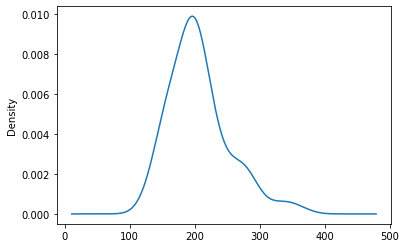

In [76]:
df_roi['max_runtime'].plot(kind='kde')

If we are to be conservative, we could prevent 95% of all failures by having a preventive mantenance at the 147th run. But doing so, we "lose" about 5931 runs that could normally operate.

In [77]:
df_roi['max_runtime'].quantile(.05)

147.0

In [78]:
sum(df_roi['max_runtime'] - 147)

5931

Using predictive maintenace, we already can predict 80% of the times if the machine have only 20 runs left. This number can increase over time with more data, and preventing failure 20 runs before, it is still probable that the machine will never reach failure.

Let's assume that we can predict all machines, in average, 20 runs before. We would "lose" aprox. 2000 runs, and not a sigle machine would fail completely. We could save approximately a **third** of the money spent if we would follow the preventive maintenance approach. And also, we would save the 5% machines that would fail while using the conservative approach.

If we consider never having a machine failing with preventive maintenance (having mainenances at the 128th run), we could save even **4 times more** with predictive maintenance.

In [79]:
(20 * 100)/sum(df_roi['max_runtime'] - 147)

0.3372112628561794

In [80]:
(20 * 100)/sum(df_roi['max_runtime'] - 128)

0.25539522410930915

But if we want to define a exact maintenance cost, we should consider also the time that machine is stopped (or nor producing) and also the sum of costs of that maintenance.

Also, we can increase the savings on that case by specifying with part in particular has broken. Some parts like o-rings and gaskets (which normally fails with low runtime) could have a lower runtime trigger (lets say 10 or 5) since they are cheap, and normally do not offers a high cost of failure, while big parts like shafts and special parts could have higher runtime triggers, as the exchage of these parts could take months to replace.